Etape 1 : importer les librairies necessaires

In [1]:
import tensorflow as tf
from tensorflow import keras
import keras_tuner as kt

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import pathlib
from pathlib import Path
import os

import imghdr
from PIL import Image
import cv2 

import itertools
import datetime

Etape 2 : Préparer l'envirronement de travail

In [2]:
# Use Python version : 3.8.8
# Use Tensorflow version : < 2.11.0
print("Tensorflow version : ", tf.__version__)

Tensorflow version :  2.10.1


In [3]:
def prepare_gpu_acceleration():
    gpus = tf.config.experimental.list_physical_devices('GPU')
    if gpus:
        print("GPU is AVAILABLE 🚀")
        print(tf.config.experimental.list_physical_devices('GPU'))
        try:
            for gpu in gpus:
                tf.config.experimental.set_memory_growth(gpu, True)
        except RuntimeError as e:
            print("An error occured while setting memory growth for GPU 💀")
            print(e)
    else:
        print("GPU is NOT AVAILABLE 🐌")
        print(tf.config.experimental.list_physical_devices())

prepare_gpu_acceleration()

GPU is AVAILABLE 🚀
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


Etape 3 : Préparer les données d'entrainement de validation et de test

In [4]:
#definir le chemin vers le répertoire recine du dataset
data_dir = "data"
data_set = pathlib.Path(data_dir)

In [5]:
# Identifier le nombre de fichier dans le dataset
def file_counter():
    counter = {}
    for subdir, dirs, files in os.walk(data_dir):
        # si le repertoire est un répertoire de classe contient des images
        if len(files) > 0:
            # récuperer le nom de la classe
            class_name = os.path.basename(subdir)
            # compter le nombre d'images dans le dictionnaire
            count = len(files)
            # enregistrer le nombre d'images dans le dictionnaire
            counter[class_name] = count

    return counter


counter = file_counter()

print("Nombre de fichiers dans le dataset : ", len(list(data_set.glob('*/*'))))
for class_name, count in counter.items():
    print(f"{class_name} : {count}")


Nombre de fichiers dans le dataset :  40671
Painting : 9993
Photo : 9993
Schematics : 9279
Sketch : 1406
Text : 10000


In [6]:
# filtrer le dataset , deplacer les images corrumpu

accepted_extensions = [".png", ".jpg", ".jpeg", ".bmp"]

corrupted_images_dir = "corrupted"

# filtrer le dataset , deplacer les images corrumpu
def move_invalid_files(file, subdir):
    if not os.path.exists(corrupted_images_dir):
        os.mkdir(corrupted_images_dir)
    invalid_image_path = os.path.join(corrupted_images_dir, file)
    os.rename(os.path.join(subdir, file), invalid_image_path)


def check_images():
    valid_count = 0
    invalid_count = 0
    count_by_class = {}
    for subdir, dirs, files in os.walk(data_dir):
        # si le repertoire est un répertoire de classe contient des images
        if len(files) > 0:
            for file in files:
                # récuperer le nom de la classe
                class_name = os.path.basename(subdir)
                if class_name not in count_by_class:
                    count_by_class[class_name] = {"valid": 0, "invalid": 0}
                # vérifier si l'extension du fichier est accepté
                if Path(file).suffix.lower() in accepted_extensions:
                    # vérifier si le fichier est une image valide
                    if imghdr.what(os.path.join(subdir, file)) is not None:
                        # check si les images ne sont pas corrompues
                        try:
                            img_bytes = tf.io.read_file(os.path.join(subdir, file))
                            decoded_img = tf.image.decode_image(img_bytes)
                            valid_count += 1
                            count_by_class[class_name]["valid"] += 1
                        except tf.errors.InvalidArgumentError as e:
                            invalid_count += 1
                            count_by_class[class_name]["invalid"] += 1
                            move_invalid_files(file, subdir)
                    else:
                        invalid_count += 1
                        count_by_class[class_name]["invalid"] += 1
                        move_invalid_files(file, subdir)
                else:
                    invalid_count += 1
                    count_by_class[class_name]["invalid"] += 1
                    move_invalid_files(file, subdir)
    return valid_count, invalid_count, count_by_class


# valid_count, invalid_count, count_by_class = check_images()
# print("🟢 valid images: ", valid_count)
# print("🔴 invalid count: ", invalid_count)
# for class_name, count in count_by_class.items():
#     print(class_name)
#     print(f"- {count['valid']} valid")
#     print(f"- {count['invalid']} invalid")


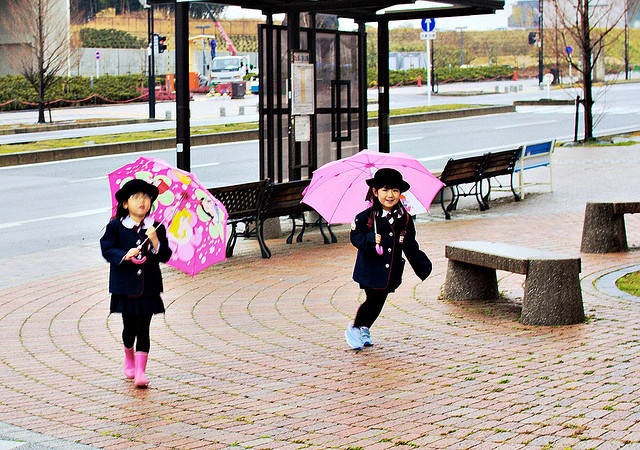

In [7]:
#afficher un echantillons du dataset
painting_images = list(data_set.glob('Photo/*'))
random_painting = np.random.choice(painting_images, 1)
Image.open(str(random_painting[0]))


In [8]:
BATCH_SIZE = 32
IMG_H = 128
IMG_W = 128
SEEDS = 10
VALIDATION_SPLIT = 0.2

In [9]:
# preparer le dataset
 
train_set = tf.keras.utils.image_dataset_from_directory(
    data_set,
    validation_split=VALIDATION_SPLIT,
    subset="training",
    seed=SEEDS,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    shuffle=True
)

val_set = tf.keras.utils.image_dataset_from_directory(
    data_set,
    validation_split=VALIDATION_SPLIT,
    subset="validation",
    seed=SEEDS,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    shuffle=True
)


Found 40671 files belonging to 5 classes.
Using 32537 files for training.
Found 40671 files belonging to 5 classes.
Using 8134 files for validation.


In [10]:
val_batches = tf.data.experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

print('Number of validation batches: %d' % tf.data.experimental.cardinality(val_set))
print('Number of test batches: %d' % tf.data.experimental.cardinality(test_set))
print('Number of train batches: %d' % tf.data.experimental.cardinality(train_set))

Number of validation batches: 204
Number of test batches: 51
Number of train batches: 1017


In [11]:
# récupérer les noms des classes du dataset
class_names = train_set.class_names
print(f"🎭 Categories : {class_names}")

🎭 Categories : ['Painting', 'Photo', 'Schematics', 'Sketch', 'Text']


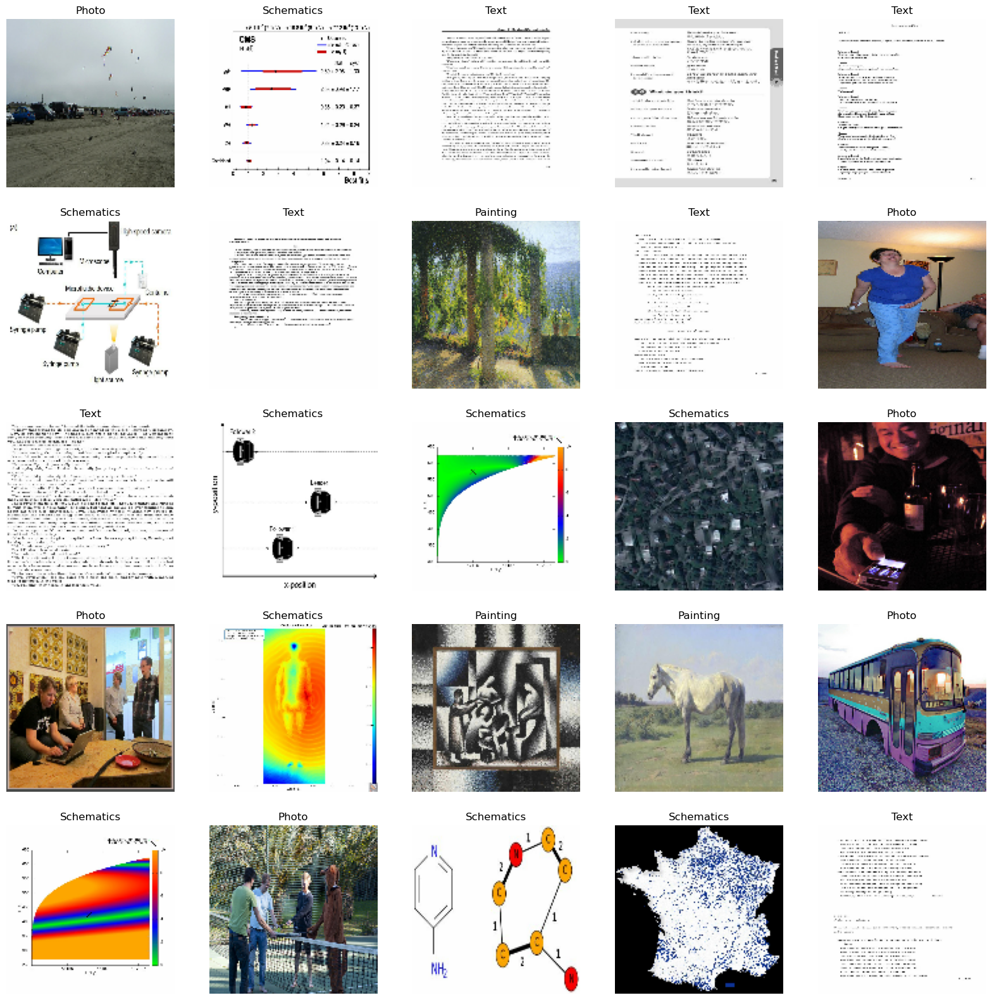

In [12]:
plt.figure(figsize=(20, 20))
for images, labels in train_set.take(1):
  for i in range(25):
    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

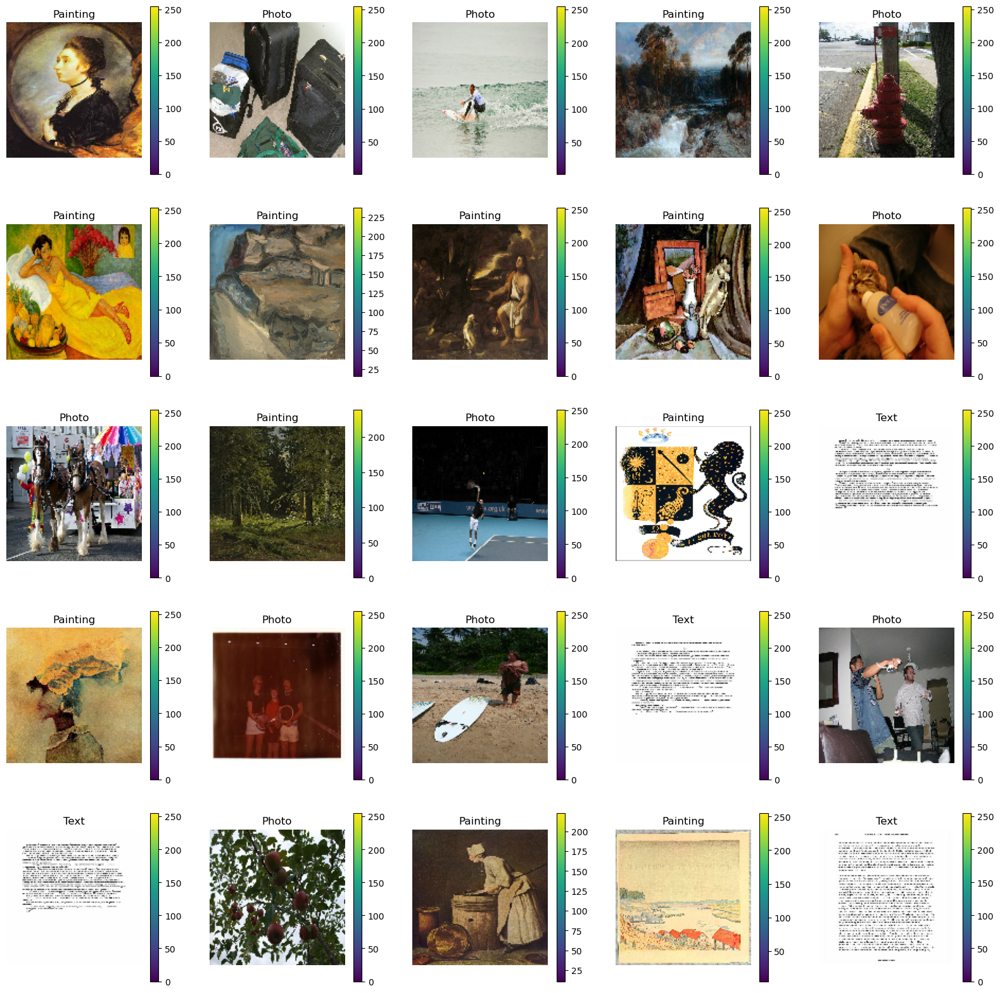

In [13]:
# afficher un echantillon du dataset
plt.figure(figsize=(20, 20))
for images, labels in train_set.take(1):
  for i in range(25):
    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.colorbar()
    plt.title(class_names[labels[i]])
    plt.axis("off")


In [14]:
print(type(train_set))
images , labels = iter(train_set).next()
print(f"🖼️ images shape : {images.shape}")
print(f"🎟️ labels shape{labels.shape}")

<class 'tensorflow.python.data.ops.dataset_ops.BatchDataset'>
🖼️ images shape : (32, 128, 128, 3)
🎟️ labels shape(32,)


In [15]:
NUM_CLASSES = len(class_names)
NO_EPOCHS = 50
SHUFFLE = 1000
RESCALING = 1./255
RANDOM_ROTATION = 0.2
RANDOM_ZOOM = 0.2
RANDOM_FILP = "horizontal_and_vertical"
LEARING_RATE = 0.0015

In [16]:
# cache conserve les images en mémoire après leur chargement hors disque au cours de la première Epoch
# prefetch chevauche le prétraitement des données et l'exécution du modèle pendant la formation.
# eviter overfitting et augmenter la vitesse d'entrainement du modele
AUTOTUNE = tf.data.AUTOTUNE
train_set = train_set.cache().shuffle(SHUFFLE).prefetch(buffer_size=AUTOTUNE)
val_set = val_set.cache().prefetch(buffer_size=AUTOTUNE)
test_set = test_set.cache().prefetch(buffer_size=AUTOTUNE)


In [17]:
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.RandomFlip(RANDOM_FILP),
  tf.keras.layers.RandomRotation(RANDOM_ROTATION),
  tf.keras.layers.RandomZoom(RANDOM_ZOOM),
])

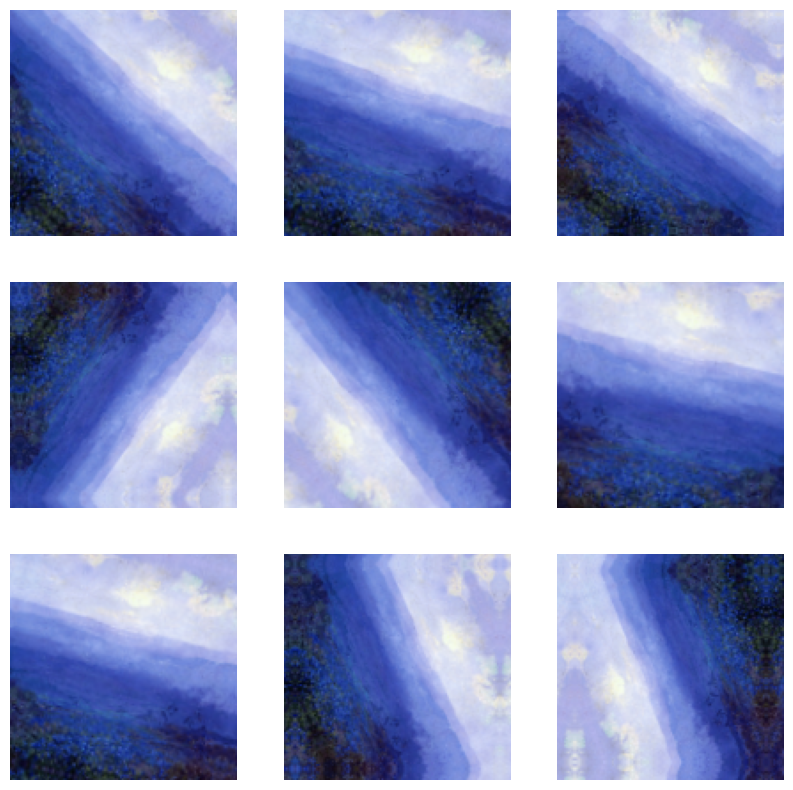

In [18]:
for image, _ in train_set.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    aug_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(aug_image[0] / 255)
    plt.axis('off')

In [19]:
normalization_layer = tf.keras.Sequential([
    tf.keras.layers.Rescaling(RESCALING)
])

🔼 image min : 0.008979588747024536
🔽 image max : 1.0


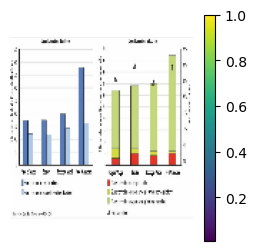

In [20]:
for image, _ in train_set.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(1):
    ax = plt.subplot(3, 3, i + 1)
    normalized_image = normalization_layer(tf.expand_dims(first_image, 0))

    plt.imshow(normalized_image[0])
    plt.colorbar()
    plt.axis('off')

print(f"🔼 image min : {normalized_image[0].numpy().min()}")
print(f"🔽 image max : {normalized_image[0].numpy().max()}")

In [21]:
model = tf.keras.Sequential([

    tf.keras.Input(shape=(IMG_H, IMG_W, 3)),
    normalization_layer,
    data_augmentation,

    tf.keras.layers.Conv2D(64, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),

    tf.keras.layers.Conv2D(128, 3, padding='same', activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),

    tf.keras.layers.Flatten(),

    tf.keras.layers.Dense(512, activation='relu',
                          kernel_regularizer=tf.keras.regularizers.l2(0.001)),
    tf.keras.layers.Dropout(0.2),
    
    tf.keras.layers.Dense(512, activation='relu',
                          kernel_regularizer=tf.keras.regularizers.l2(0.001)),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])


In [22]:
# compiler le model optimizer=keras.optimizers.Adam(learning_rate=0.00015)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARING_RATE),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(),
    metrics=['accuracy']
)


In [23]:
data_augmentation.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 random_flip (RandomFlip)    (None, 128, 128, 3)       0         
                                                                 
 random_rotation (RandomRota  (None, 128, 128, 3)      0         
 tion)                                                           
                                                                 
 random_zoom (RandomZoom)    (None, 128, 128, 3)       0         
                                                                 
Total params: 0
Trainable params: 0
Non-trainable params: 0
_________________________________________________________________


In [24]:
normalization_layer.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
Total params: 0
Trainable params: 0
Non-trainable params: 0
_________________________________________________________________


In [25]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 sequential (Sequential)     (None, 128, 128, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 128, 128, 64)      1792      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 128)       73856     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 128)      0         
 2D)                                                  

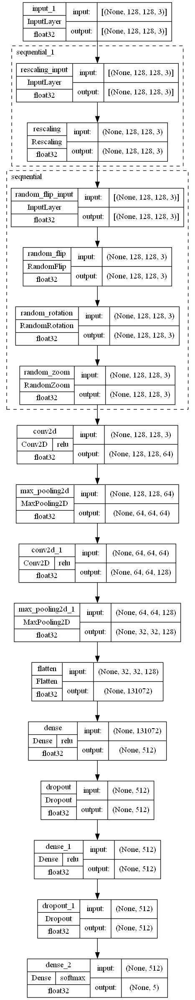

In [26]:
schema_file = "architecture/model_CNN_multiclass.png"

 
tf.keras.utils.plot_model(
    model,
    to_file=schema_file,
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True
)

In [27]:
# Definition de la validation croisée
models_dir = 'models/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + '/' + 'model.h5'
logs_dir = "logs/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")


In [28]:
callbacks = [
    tf.keras.callbacks.TensorBoard(log_dir=logs_dir , histogram_freq=1),
    tf.keras.callbacks.ModelCheckpoint(models_dir, verbose=1, save_best_only=True),
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, verbose=1, mode='auto') , 
]

In [29]:
hist = model.fit(
    train_set,
    epochs=NO_EPOCHS,
    validation_data=val_set,
    verbose=1,
    callbacks=callbacks
)

Epoch 1/50
1017/1017 [==============================] - ETA: 0s - loss: 1.2076 - accuracy: 0.6268

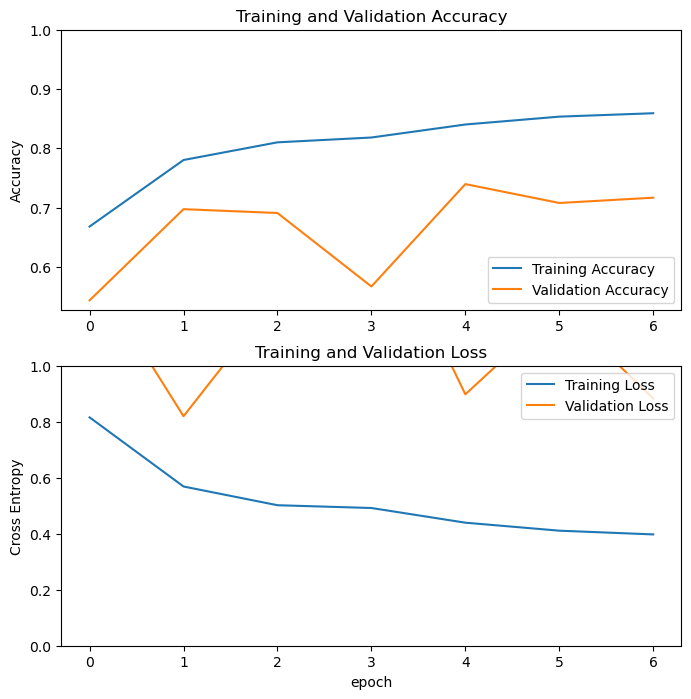

In [ ]:
acc = hist.history['accuracy']
val_acc = hist.history['val_accuracy']

loss = hist.history['loss']
val_loss = hist.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
loss, acc = model.evaluate(val_set, verbose=1)

print("initial loss: {:.2f}".format(loss))
print("initial accuracy: {:.2f}".format(acc))

204/204 [==============================] - 1s 6ms/step - loss: 0.8827 - accuracy: 0.7167
initial loss: 0.88
initial accuracy: 0.72


1/1 [==============================] - 0s 254ms/step
Labels:  [2 4 2 2 2 4 2 4 4 1 4 2 0 0 1 0 0 1 2 4 1 0 0 4 1 4 4 1 0 0 2 4]
Predicted labels:  [2 2 2 2 2 4 2 4 4 2 3 2 2 1 1 1 0 1 2 2 1 1 1 4 1 2 4 1 0 0 2 4]


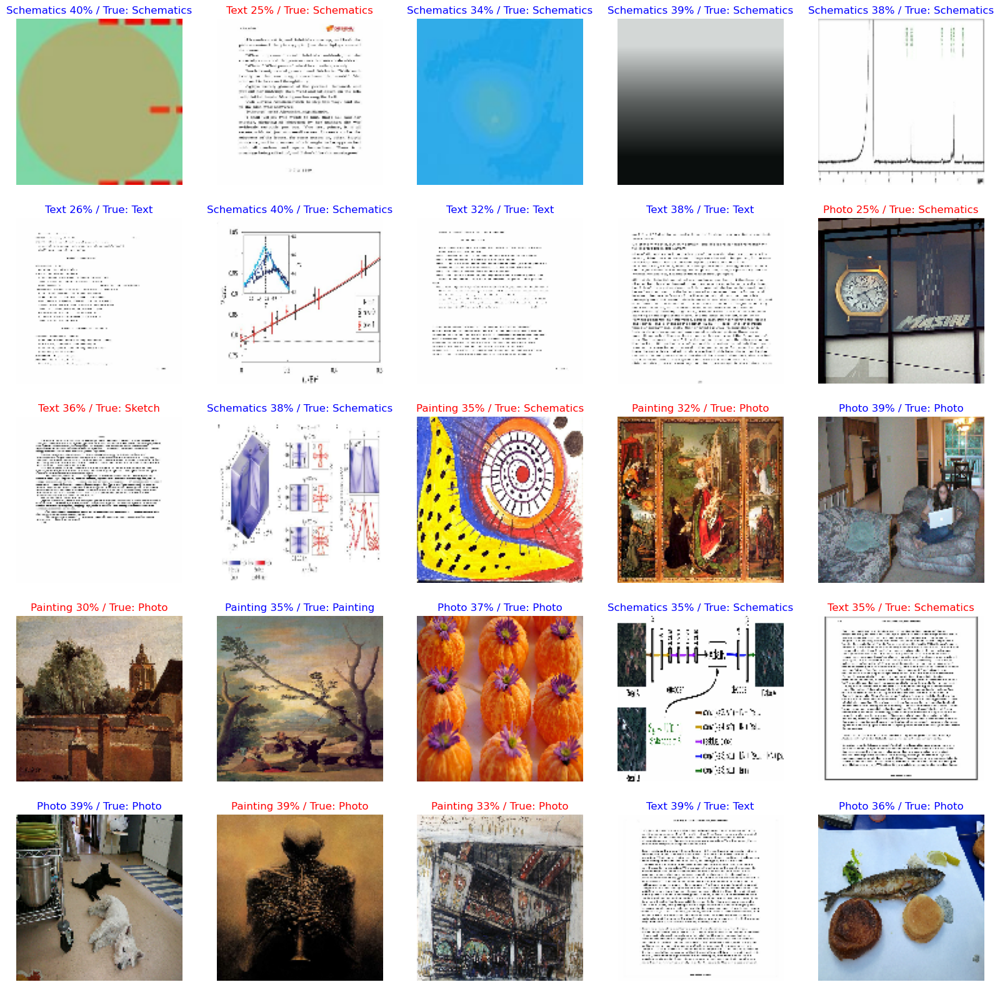

In [ ]:
image_batch, label_batch = test_set.as_numpy_iterator().next()

predictions = model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)


print("Labels: ", label_batch)
print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    label = label_batch[i]
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if predicted_label == label else "red"

    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)
    plt.title("{} {}% / True: {}".format(class_names[label],
              int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


In [ ]:
# load the best model
best_model = tf.keras.models.load_model(models_dir)

# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = best_model.evaluate(test_set, batch_size=128)
print("test loss, test acc:", results)

Evaluate on test data
51/51 [==============================] - 3s 47ms/step - loss: 0.8264 - accuracy: 0.6752
test loss, test acc: [0.8263763785362244, 0.6752451062202454]


1/1 [==============================] - 0s 102ms/step
Labels:  [0 0 2 0 1 4 0 1 2 4 2 1 2 4 0 4 2 4 2 1 2 0 4 4 0 0 0 0 0 2 0 2]
Predicted labels:  [1 4 2 1 2 4 0 1 2 4 2 0 2 4 1 2 2 4 1 1 2 0 2 4 0 1 2 1 0 2 1 2]


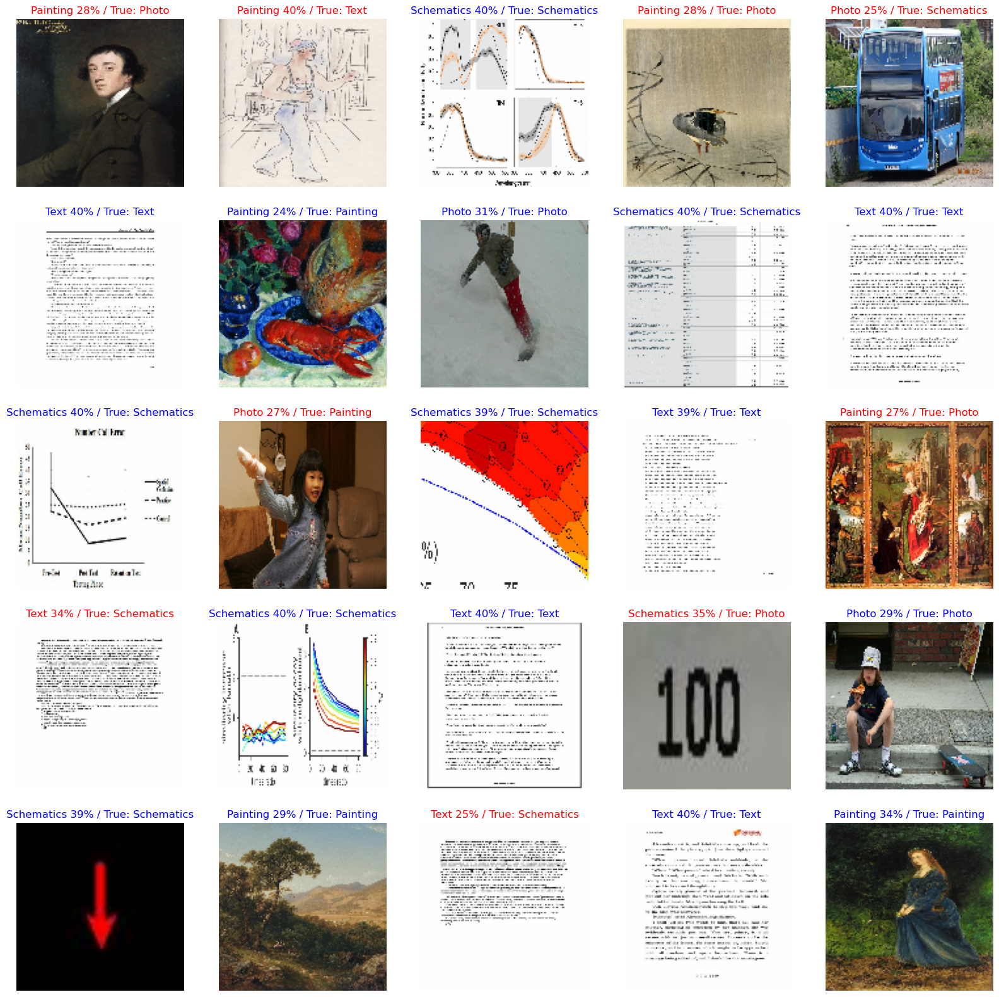

In [ ]:
image_batch, label_batch = test_set.as_numpy_iterator().next()

predictions = best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)


print("Labels: ", label_batch)
print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    label = label_batch[i]
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if predicted_label == label else "red"

    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)
    plt.title("{} {}% / True: {}".format(class_names[label],
              int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


In [ ]:
data_set_to_classify_dir = os.path.join("test")
# saved_model_dir = "models_best_fit/model_multiclass_CNN.h5"
saved_model_dir = models_dir

# load the model on model_dir and classify the data in data_set_to_classify_dir

# load the best model
saved_best_model = tf.keras.models.load_model(saved_model_dir)

In [ ]:
test_final_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    data_set_to_classify_dir,
    shuffle=True,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    ) 

Found 148 files belonging to 1 classes.


1/1 [==============================] - 0s 101ms/step
Predicted labels:  [1 0 2 1 2 1 2 1 1 1 1 1 1 1 1 2 1 1 2 1 1 2 1 1 1 0 0 1 1 0 1 1]


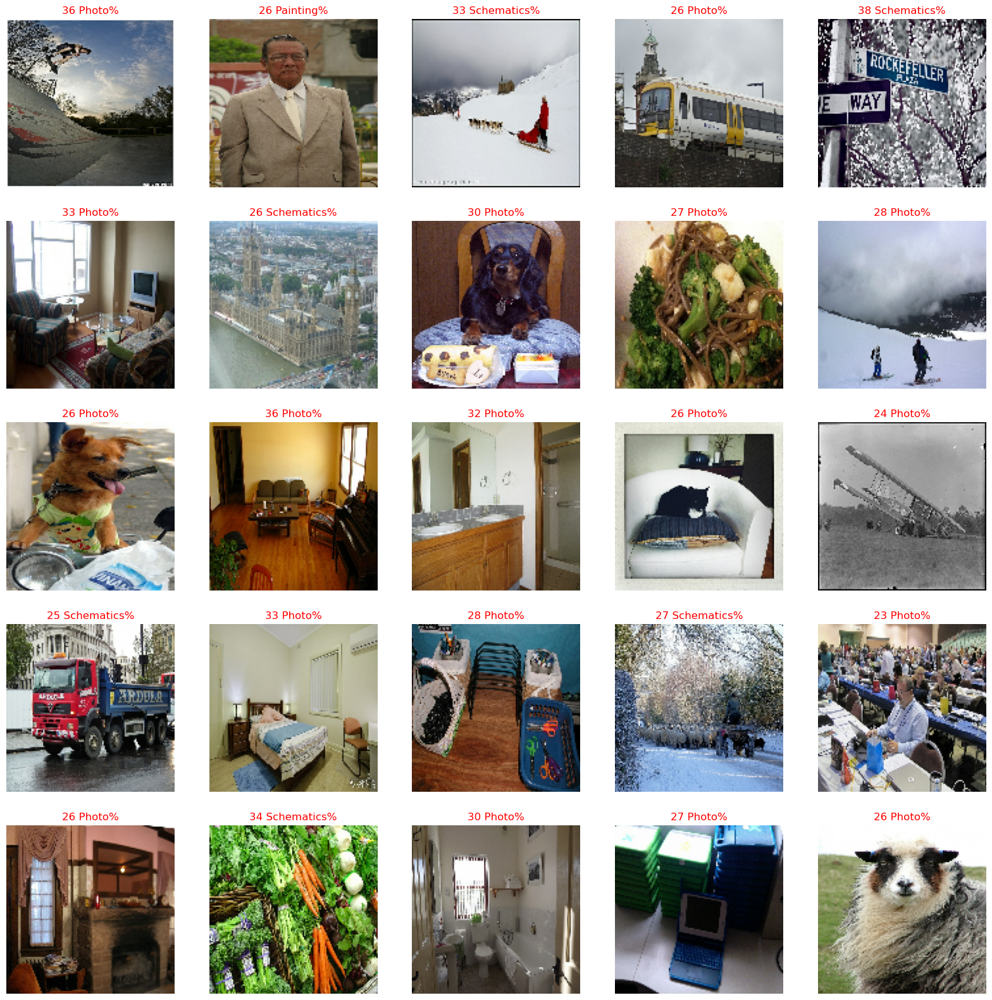

In [ ]:
image_batch, label_batch = test_final_dataset.as_numpy_iterator().next()

predictions = saved_best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)

print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if int(predicted_prob*100) > 50 else "red"


    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)

    plt.title("{} {}%".format(int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


In [ ]:
# # enregistrement du modèle
# saved_model_dir = "models_best_fit/model_multiclass_CNN.h5"

# tf.keras.models.save_model(
#     saved_best_model,
#     saved_model_dir,
#     overwrite=True,
#     include_optimizer=True,
#     save_format=None,
#     signatures=None,
#     options=None
# )



Creation d'un hypermodèle 

In [71]:
def hyper_model_builder(hyper_parameter):
    model = tf.keras.Sequential()

    model.add(tf.keras.Input(shape=(IMG_H, IMG_W, 3)))
    model.add(tf.keras.layers.experimental.preprocessing.Rescaling(1./255))

    # model.add(tf.keras.layers.RandomFlip(RANDOM_FILP)),
    # model.add(tf.keras.layers.RandomRotation(RANDOM_ROTATION)),
    # model.add(tf.keras.layers.RandomZoom(RANDOM_ZOOM)),

    model.add(tf.keras.layers.Conv2D(
        filters=32,
        kernel_size=3,
        strides=1,
        padding='same',
        activation='relu',
    )),
    model.add(tf.keras.layers.MaxPooling2D((2, 2))),
    model.add(tf.keras.layers.Conv2D(
        filters=64,
        kernel_size=3,
        strides=1,
        padding='same',
        activation='relu',
    )),
    model.add(tf.keras.layers.MaxPooling2D((2, 2))),
    model.add(tf.keras.layers.Conv2D(
        filters=128,
        kernel_size=3,
        strides=1,
        padding='same',
        activation='relu',
    )),
    model.add(tf.keras.layers.MaxPooling2D((2, 2))),
    model.add(tf.keras.layers.Flatten())

    # Tune the number of units in the first Dense layer
    # Choose an optimal value between 32-512
    hp_units = hyper_parameter.Int(
        'units', min_value=128, max_value=1000, step=16)
    hp_dropout = hyper_parameter.Float(
        'dropout', min_value=0.0, max_value=0.5, step=0.1)
    hp_units_2 = hyper_parameter.Int(
        'units_l2', min_value=128, max_value=1000, step=32)
    hp_dropout_2 = hyper_parameter.Float(
        'dropout_l2', min_value=0.0, max_value=0.5, step=0.1)
    hp_units_3 = hyper_parameter.Int(
        'units_l3', min_value=128, max_value=1000, step=64)
    hp_dropout_3 = hyper_parameter.Float(
        'dropout_l3', min_value=0.0, max_value=0.5, step=0.1)

    model.add(tf.keras.layers.Dense(units=hp_units, activation='relu'))
    model.add(tf.keras.layers.Dropout(rate=hp_dropout))

    model.add(tf.keras.layers.Dense(units=hp_units_2, activation='relu'))
    model.add(tf.keras.layers.Dropout(rate=hp_dropout_2))

    model.add(tf.keras.layers.Dense(NUM_CLASSES))

    # Tune the learning rate for the optimizer
    # Choose an optimal value from 0.01, 0.001, or 0.0001
    hp_learning_rate = hyper_parameter.Choice(
        'learning_rate', values=[1e-2, 1e-3, 1e-4])

    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=hp_learning_rate),
        loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        metrics=['accuracy']
    )

    return model


In [73]:
MAX_EPOCHS=10
FACTOR=3

tuner = kt.Hyperband(
    hyper_model_builder,
    objective='val_accuracy',
    max_epochs=MAX_EPOCHS,
    factor=FACTOR,
    directory='tuning',
    project_name='hypermodel_multiclass_CNN'
)

In [74]:
models_dir = 'models/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + '/' + 'hypermodel.h5'
logs_dir = "logs/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, verbose=1, mode='auto')
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(models_dir, monitor='val_loss', verbose=1, save_best_only=True, mode='auto')
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logs_dir, histogram_freq=1)

In [75]:
# Exécutez la recherche d'hyperparamètres

img_train, label_train = train_set.as_numpy_iterator().next()

tuner.search(
    img_train, label_train,
    epochs=50,
    validation_split=0.2,
    callbacks=[stop_early, model_checkpoint, tensorboard_callback]
)

# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]


Trial 30 Complete [00h 00m 09s]
val_accuracy: 0.5714285969734192

Best val_accuracy So Far: 0.7142857313156128
Total elapsed time: 00h 04m 07s
INFO:tensorflow:Oracle triggered exit


In [76]:
print(f"""
The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is {best_hps.get('units')} and the optimal learning rate for the optimizer
is {best_hps.get('learning_rate')}. and the optimal dropout rate for the Dropout layer
is {best_hps.get('dropout')}. and the optimal number of units in the second densely-connected
layer is {best_hps.get('units_l2')} and the optimal dropout rate for the Dropout layer
is {best_hps.get('dropout_l2')}.
is {best_hps.get('dropout')}. and the optimal number of units in the third densely-connected
layer is {best_hps.get('units_l3')} and the optimal dropout rate for the Dropout layer
is {best_hps.get('dropout_l3')}.
""")


The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is 224 and the optimal learning rate for the optimizer
is 0.0001. and the optimal dropout rate for the Dropout layer
is 0.30000000000000004. and the optimal number of units in the second densely-connected
layer is 448 and the optimal dropout rate for the Dropout layer
is 0.30000000000000004.
is 0.30000000000000004. and the optimal number of units in the third densely-connected
layer is 192 and the optimal dropout rate for the Dropout layer
is 0.1.



In [77]:
hypermodel = tuner.hypermodel.build(best_hps)

hypermodel.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, 128, 128, 3)       0         
                                                                 
 conv2d_4 (Conv2D)           (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 64, 64, 16)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 32, 32, 32)       0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 32, 32, 64)       

In [78]:
hp_hist = hypermodel.fit(
    train_set,
    epochs=50,
    validation_data=val_set,
    callbacks=[stop_early, model_checkpoint, tensorboard_callback]
)

val_acc_per_epoch = hp_hist.history['val_accuracy']
best_epoch = val_acc_per_epoch.index(max(val_acc_per_epoch)) + 1
print('Best epoch: %d' % (best_epoch,))

Epoch 1/50
1015/1017 [============================>.] - ETA: 0s - loss: 0.7009 - accuracy: 0.6963
Epoch 1: val_loss improved from inf to 0.44962, saving model to models/20230106-130619\hypermodel.h5
1017/1017 [==============================] - 63s 61ms/step - loss: 0.7003 - accuracy: 0.6967 - val_loss: 0.4496 - val_accuracy: 0.8219
Epoch 2/50
1015/1017 [============================>.] - ETA: 0s - loss: 0.4570 - accuracy: 0.8131
Epoch 2: val_loss improved from 0.44962 to 0.37127, saving model to models/20230106-130619\hypermodel.h5
1017/1017 [==============================] - 62s 61ms/step - loss: 0.4569 - accuracy: 0.8130 - val_loss: 0.3713 - val_accuracy: 0.8482
Epoch 3/50
1017/1017 [==============================] - ETA: 0s - loss: 0.3805 - accuracy: 0.8470
Epoch 3: val_loss improved from 0.37127 to 0.31276, saving model to models/20230106-130619\hypermodel.h5
1017/1017 [==============================] - 62s 61ms/step - loss: 0.3805 - accuracy: 0.8470 - val_loss: 0.3128 - val_accurac

In [79]:
hypermodel = tuner.hypermodel.build(best_hps)

# Retrain the model
hp_hist = hypermodel.fit(train_set,
               epochs=best_epoch,
               validation_data=val_set,
               callbacks=[stop_early, model_checkpoint, tensorboard_callback])


Epoch 1/17
1015/1017 [============================>.] - ETA: 0s - loss: 0.7102 - accuracy: 0.6860
Epoch 1: val_loss did not improve from 0.21132
1017/1017 [==============================] - 64s 62ms/step - loss: 0.7099 - accuracy: 0.6861 - val_loss: 0.4926 - val_accuracy: 0.7870
Epoch 2/17
1014/1017 [============================>.] - ETA: 0s - loss: 0.4786 - accuracy: 0.7970
Epoch 2: val_loss did not improve from 0.21132
1017/1017 [==============================] - 63s 62ms/step - loss: 0.4783 - accuracy: 0.7972 - val_loss: 0.3912 - val_accuracy: 0.8384
Epoch 3/17
1014/1017 [============================>.] - ETA: 0s - loss: 0.4041 - accuracy: 0.8336
Epoch 3: val_loss did not improve from 0.21132
1017/1017 [==============================] - 63s 61ms/step - loss: 0.4041 - accuracy: 0.8335 - val_loss: 0.3374 - val_accuracy: 0.8624
Epoch 4/17
1017/1017 [==============================] - ETA: 0s - loss: 0.3495 - accuracy: 0.8575
Epoch 4: val_loss did not improve from 0.21132
1017/1017 [====

In [80]:
eval_result = hypermodel.evaluate(test_set)
print("[test loss, test accuracy]:", eval_result)

51/51 [==============================] - 3s 42ms/step - loss: 0.2489 - accuracy: 0.9136
[test loss, test accuracy]: [0.2489442378282547, 0.9136029481887817]


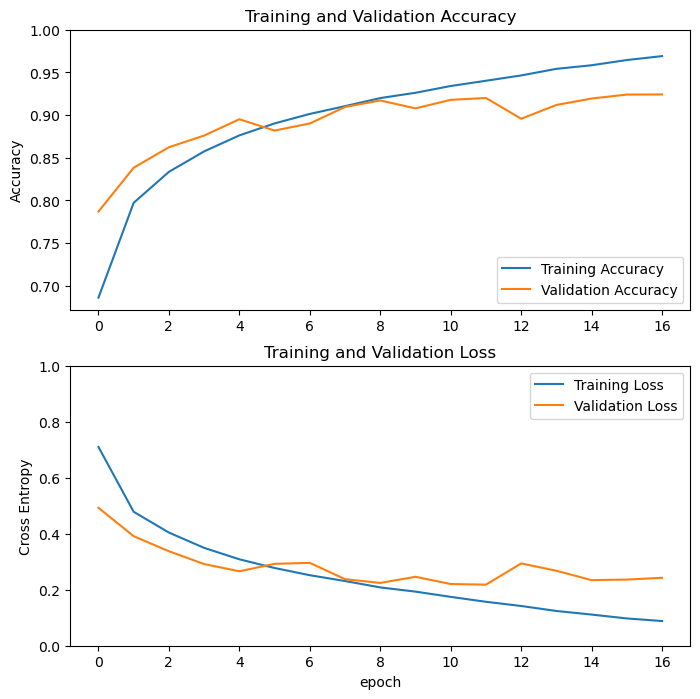

In [81]:
acc = hp_hist.history['accuracy']
val_acc = hp_hist.history['val_accuracy']

loss = hp_hist.history['loss']
val_loss = hp_hist.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

1/1 [==============================] - 0s 97ms/step
Labels:  [2 1 4 4 0 0 0 1 0 4 0 1 4 1 1 2 2 2 0 2 2 1 0 0 0 2 1 4 2 0 4 0]
Predicted labels:  [2 1 4 4 2 0 2 1 0 4 0 1 4 1 1 2 2 2 0 2 2 1 0 0 0 2 1 4 2 0 4 0]


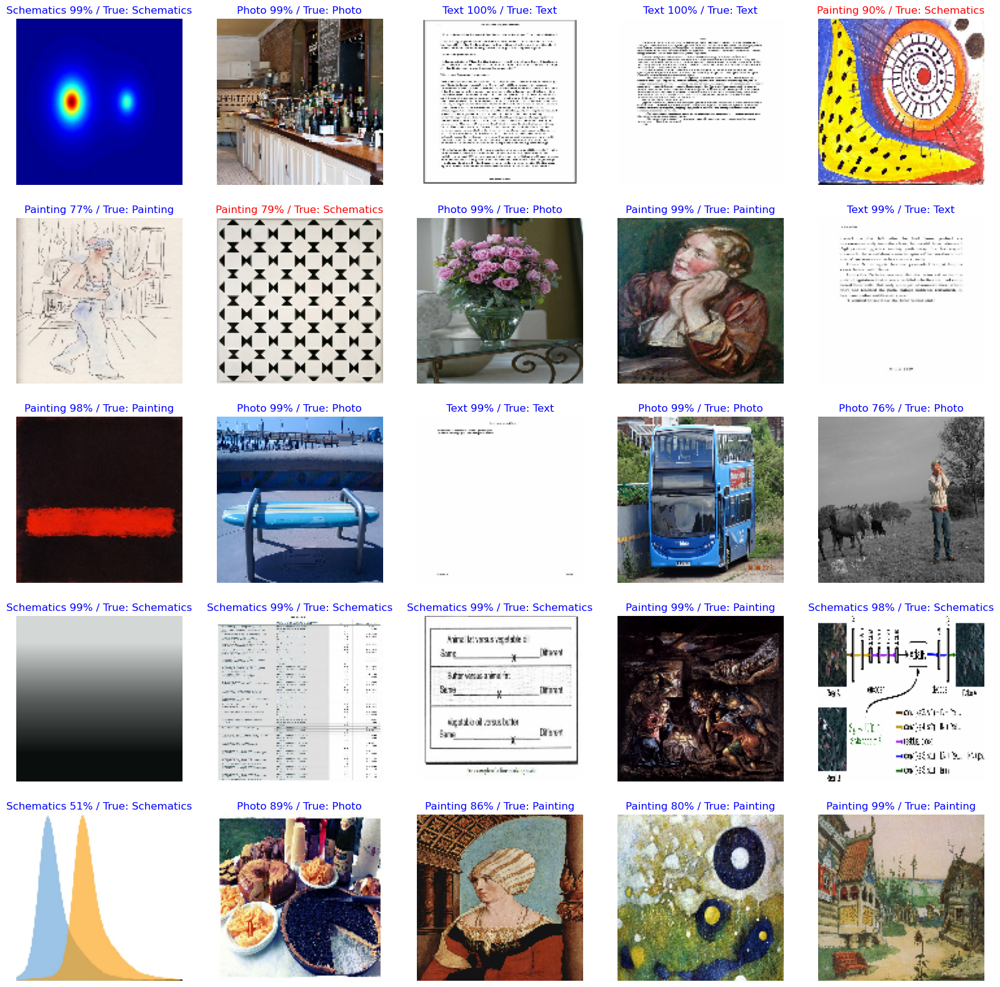

In [82]:
image_batch, label_batch = test_set.as_numpy_iterator().next()

predictions = hypermodel.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)


print("Labels: ", label_batch)
print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    label = label_batch[i]
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if predicted_label == label else "red"

    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)
    plt.title("{} {}% / True: {}".format(class_names[label],
              int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


In [83]:
# load the best model
best_model = tf.keras.models.load_model(models_dir)

# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = best_model.evaluate(test_set, batch_size=128)
print("test loss, test acc:", results)

Evaluate on test data
51/51 [==============================] - 3s 41ms/step - loss: 0.2153 - accuracy: 0.9148
test loss, test acc: [0.2153264433145523, 0.9148284196853638]


1/1 [==============================] - 0s 80ms/step
Labels:  [0 1 2 4 2 0 1 0 2 1 0 4 2 2 2 0 4 2 1 1 2 1 0 2 1 1 4 4 4 0 2 0]
Predicted labels:  [0 1 2 4 2 0 1 0 2 1 1 4 2 2 2 2 4 2 1 0 2 1 0 2 1 1 4 4 4 0 2 0]


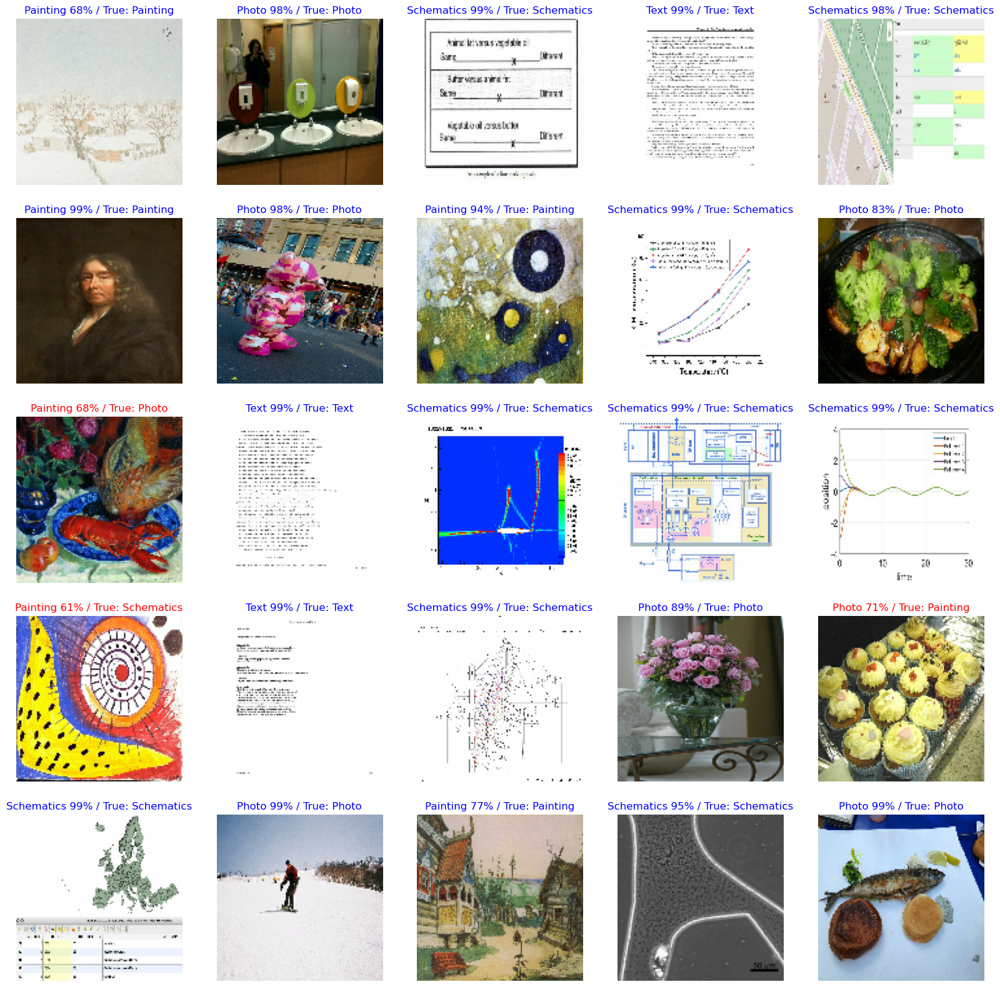

In [84]:
image_batch, label_batch = test_set.as_numpy_iterator().next()

predictions = best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)


print("Labels: ", label_batch)
print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    label = label_batch[i]
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if predicted_label == label else "red"

    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)
    plt.title("{} {}% / True: {}".format(class_names[label],
              int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


In [85]:
data_set_to_classify_dir = os.path.join("test")
# saved_model_dir = "models_best_fit/model_multiclass_CNN.h5"
saved_model_dir = models_dir

# load the model on model_dir and classify the data in data_set_to_classify_dir

# load the best model
saved_best_model = tf.keras.models.load_model(saved_model_dir)

In [86]:
test_final_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    data_set_to_classify_dir,
    shuffle=True,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    ) 

Found 148 files belonging to 1 classes.


1/1 [==============================] - 0s 82ms/step
Predicted labels:  [1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1]


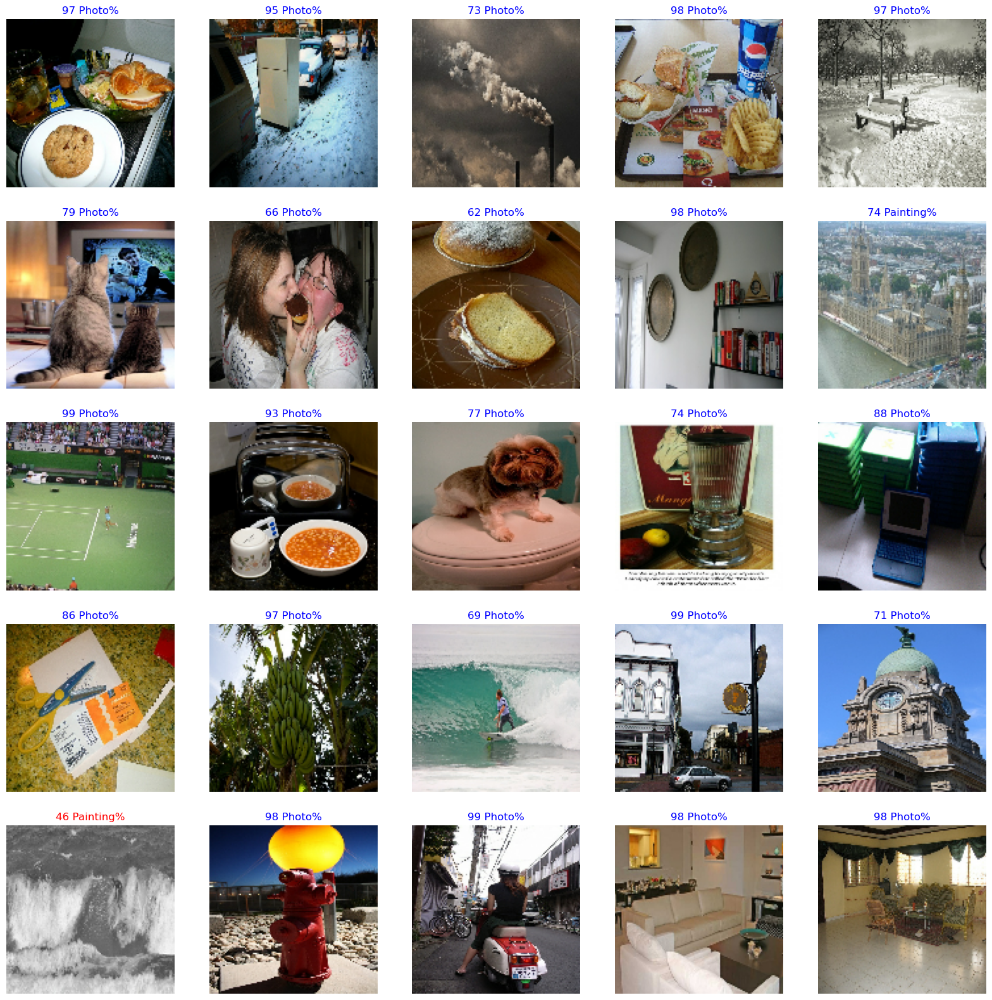

In [87]:
image_batch, label_batch = test_final_dataset.as_numpy_iterator().next()

predictions = saved_best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)

print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if int(predicted_prob*100) > 50 else "red"


    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)

    plt.title("{} {}%".format(int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")
